# <span style="color:darkblue"> Exploratory Data Analysis 🔎</span>

*por [Berenice](https://github.com/BereniceMtzT) y [Mich](https://github.com/sainosmichelle)*

En este notebook vamos a aprender cómo podemos resolver preguntas de investigación usando Python, específicamente la librería de Plotly.

En este ejemplo utilizaremos datos sísmicos históricos. Esta base de datos es una colección de más de 23,000 sismos en USA. Contiene datos desde 1638 a 1985, esto incluye información correspondiente a las coordenadas del epicentro, magnitudes, profundidad focal, nombres, coordenadas de ciudades reportadas, intensidades reportadas y la distancia de la ciudad al epicentro. Se puede encontrar más información de este dataset en: [Dataset link](https://www.kaggle.com/srijya/us-earthquake-intensity-database).

La idea no es convertirnos en expertos en sismología, 😎 este tema será una gran excusa para poder <span style="color:black"> <b>resolver preguntas sobre un conjunto de datos históricos.</b></span>

## Objetivos
- Importar librerías nuevas
- Limpieza y manipulación de datos usando pandas
- Visualizar de forma dinámica datos históricos
- Resolver preguntas usando dichas visualizaciones



## Importación de los módulos que usaremos

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

import plotly.graph_objects as go
import plotly.express as px

## Cargando el archivo de datos
Recordemos que estos datos son desde 1638 a 1985! por lo que la carga puede ser un poco lenta 🐌

In [2]:
path = 'CoCoLessons'
name = 'eqint_tsqp.csv'

In [3]:
# set path
data_path = Path(".") / name

#open file
sismosdf = pd.read_csv(data_path)
sismosdf.head()

,YEAR,MONTH,DAY,HOUR,MINUTE,SECOND,LOCAL_TO_UTC,UNPUB_OR_GROUPED_INT,LATITUDE,LONGITUDE,MAGNITUDE,EQ_DEPTH,EPIDIST,CITY_LAT,CITY_LON,MMI,STATE,CITY,SOURCE,COUNTRY
0,1852,11.0,27.0,NaN,NaN,NaN,8.0,NaN,34.5,-119.0,NaN,NaN,0.0,34.50,-119.00,7.0,CA,LOCKWOOD VALLEY,H,USA
1,1852,11.0,27.0,NaN,NaN,NaN,8.0,NaN,34.5,-119.0,NaN,NaN,258.0,33.02,-116.84,6.0,CA,SAN DIEGO,H,USA
2,1852,11.0,27.0,NaN,NaN,NaN,8.0,NaN,34.5,-119.0,NaN,NaN,159.0,35.35,-120.41,6.0,CA,SAN LUIS OBISPO,H,USA
3,1852,11.0,27.0,NaN,NaN,NaN,8.0,NaN,34.5,-119.0,NaN,NaN,NaN,NaN,NaN,6.0,CA,COLORADO RIVER,H,USA
4,1860,11.0,12.0,NaN,NaN,NaN,8.0,NaN,41.0,-124.0,NaN,NaN,32.0,40.76,-124.22,8.0,CA,HUMBOLDT BAY,H,USA



¿Cuántas instancias tenemos?

In [4]:
sismosdf.shape

(157015, 20)

## Visualicemos nuestro conjunto de datos...
¿Cómo podemos ver cuántos valores Nulos tenemos en este conjunto?

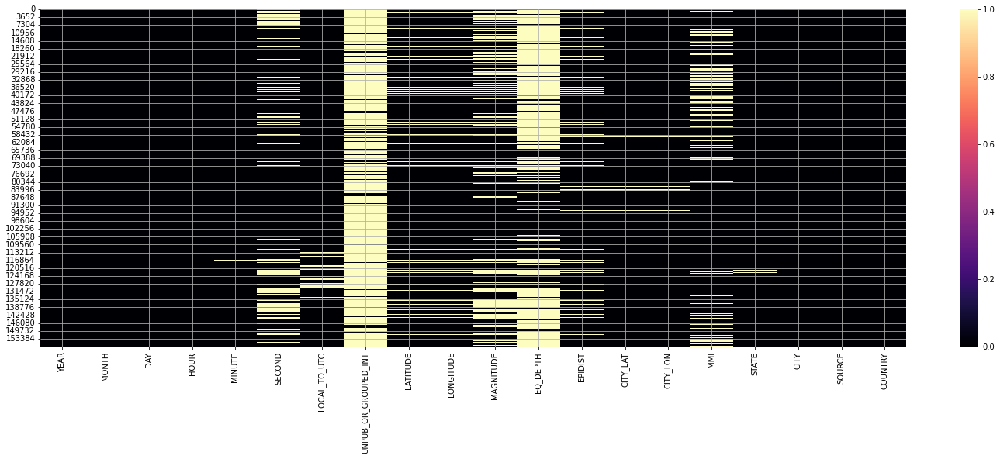

In [5]:
fig, ax = plt.subplots(figsize=(25,8))
sns.heatmap(sismosdf.isnull(), ax=ax, cmap="magma")
plt.grid()
plt.show()

## Detengámonos a pensar 🤔💡...

- ¿Qué columnas tienen menor cantidad de datos? 
- ¿Cuál es la mejor forma de tratar este conjunto NaN's?
- ¿Qué columnas son útiles y no muy útiles para el análisis?

## Eliminemos columnas!

Una forma de deshacernos de estas columnas indeseables es usando <b>drop</b> 

In [6]:
sismosdf.drop(['UNPUB_OR_GROUPED_INT','LATITUDE','LONGITUDE','EQ_DEPTH', 'LOCAL_TO_UTC'], axis=1, inplace=True)

In [7]:
sismosdf.head()

,YEAR,MONTH,DAY,HOUR,MINUTE,SECOND,MAGNITUDE,EPIDIST,CITY_LAT,CITY_LON,MMI,STATE,CITY,SOURCE,COUNTRY
0,1852,11.0,27.0,NaN,NaN,NaN,NaN,0.0,34.50,-119.00,7.0,CA,LOCKWOOD VALLEY,H,USA
1,1852,11.0,27.0,NaN,NaN,NaN,NaN,258.0,33.02,-116.84,6.0,CA,SAN DIEGO,H,USA
2,1852,11.0,27.0,NaN,NaN,NaN,NaN,159.0,35.35,-120.41,6.0,CA,SAN LUIS OBISPO,H,USA
3,1852,11.0,27.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,CA,COLORADO RIVER,H,USA
4,1860,11.0,12.0,NaN,NaN,NaN,NaN,32.0,40.76,-124.22,8.0,CA,HUMBOLDT BAY,H,USA


## ¿Cómo sustituimos valores faltantes en el resto de las columnas?

Empecemos por la columna de segundos...

In [8]:
sismosdf['SECOND'].fillna(0, inplace=True)

¿Qué pasa con las columnas de minutos y horas?

In [9]:
sismosdf['MINUTE'].fillna(sismosdf['MINUTE'].mode(), inplace=True)
sismosdf['HOUR'].fillna(sismosdf['HOUR'].mode(), inplace=True)

¿y distancia epicentral?

In [10]:
sismosdf['EPIDIST'].fillna(sismosdf['EPIDIST'].mean(), inplace=True)

Una forma más drástica de deshacernos de los valores nulos es la siguiente 👇👇. 

⚠️ Esto puede no ser muy recomendable cuando se tienen pocas instancias.

In [11]:
sismosdf = sismosdf[sismosdf.MMI.notnull()]
sismosdf = sismosdf[sismosdf.YEAR.notnull()]
sismosdf = sismosdf[sismosdf.MONTH.notnull()]
sismosdf = sismosdf[sismosdf.DAY.notnull()]
sismosdf = sismosdf[sismosdf.CITY_LAT.notnull()]
sismosdf = sismosdf[sismosdf.CITY_LON.notnull()]
sismosdf = sismosdf[sismosdf.MAGNITUDE.notnull()]
sismosdf = sismosdf[sismosdf.STATE.notnull()]

Visualicemos gráficamente nuestro dataset de forma gráfica...

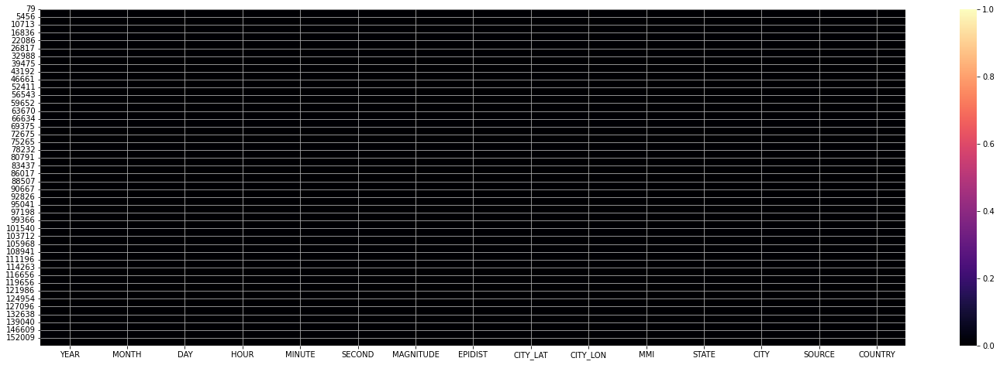

In [12]:
fig, ax = plt.subplots(figsize=(25,8))
sns.heatmap(sismosdf.isnull(), ax=ax, cmap="magma")
plt.grid()
plt.show()

¿Cuántas instancias nos quedan? ¿Qué pasó? 😧

In [13]:
sismosdf.shape

(89573, 15)

## Comencemos con el análisis de estos datos históricos 🙌

El análisis exploratorio de los datos (EDA) es el primer paso en la cadena de ingeniería de datos. Con un conjunto de datos históricos usualmente queremos resolver preguntas relevantes para nuestra investigación, por ejemplo:

- ¿<b>Cuándo</b> sucedió algún evento?
- ¿<b>Dónde</b> ocurrió?
- ¿<b>Cómo</b> se ve la ditribución de ciertos eventos?
- Eventualmente queremos responder el ¿<b>Por qué</b> ocurrió? a partir de los datos

Para resolver preguntas sobre este conjunto de datos usaremos visualizaciones. En algunos casos usaremos las librerías de Seaborn y Matplotlib pero también usaremos una librería nueva llamada Plotly.

## ¿Qué es Plotly?

[Plotly](https://plotly.com/python/) es una librería open-source para hacer gráficos <b>interactivos</b> y con calidad de publicación. En la documentación oficial se muestran ejemplos para hacer distintos plots y charts.

## Comencemos resolviendo una pregunta sencilla...

¿Cuál es la <b>intensidad más frecuente</b> en el conjunto de datos?. Pensemos y razonemos la pregunta..

¿Cómo lo resolverías? Recuerda que la columna de Intensidad se llama MMI


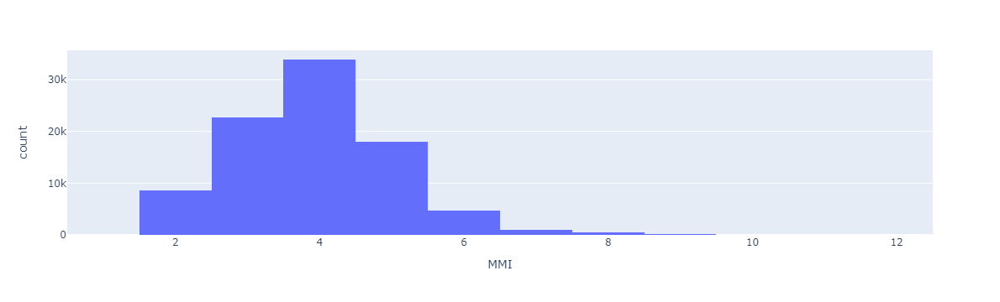

In [14]:
px.histogram(sismosdf, x='MMI', barmode='group')

## ¿De dónde provienen nuestros datos?...
Primero veamos de qué países son nuestros datos

In [15]:
sismosdf['COUNTRY'].value_counts()

USA              88428
CANADA             863
USA TERRITORY      248
MEXICO              34
Name: COUNTRY, dtype: int64

La mayor parte de nuestros datos provienen de: 
- USA
- CANADA

Pero observemos que tanta información representan otros países con un <b>PIE CHART</b>...

In [16]:
sismosdf['COUNTRY'].value_counts().index

Index(['USA', 'CANADA', 'USA TERRITORY', 'MEXICO'], dtype='object')

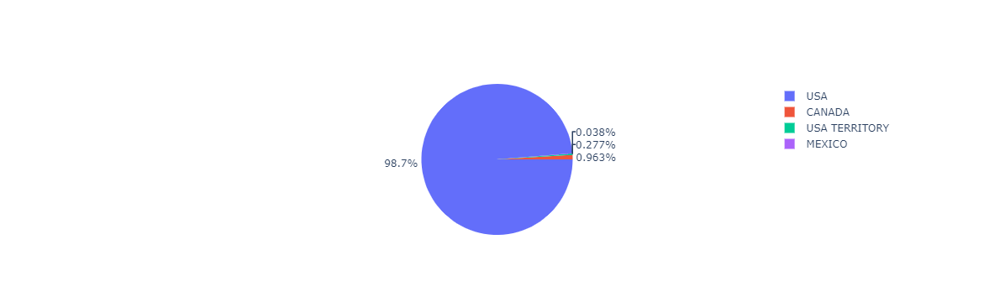

In [17]:
trace = go.Pie(labels=sismosdf['COUNTRY'].value_counts().index,  
                values=sismosdf['COUNTRY'].value_counts(), 
                textposition='outside',                
                rotation=90)
layout = go.Layout(
                   title="Percentage of events",
                   font=dict(family='Arial', size=12, color='#909090'),
                   legend=dict(x=0.9, y=0.5)
                    )
data = [trace]

fig = go.Figure(data=data)
fig.show()

Cambiemos el tipo de visualización a un <b>BAR PLOT</b> para mejorar la representación de las clases

## ¿Cuál es la magnitud más frecuente?

Recordemos que la columna de Magnitud de los sismos es MAGNITUDE. 
- ¿Con qué tipo de gráfico representarían esta respuesta?
- En Cánada ¿Cuál es la magnitud <b>MENOS</b> frecuente?

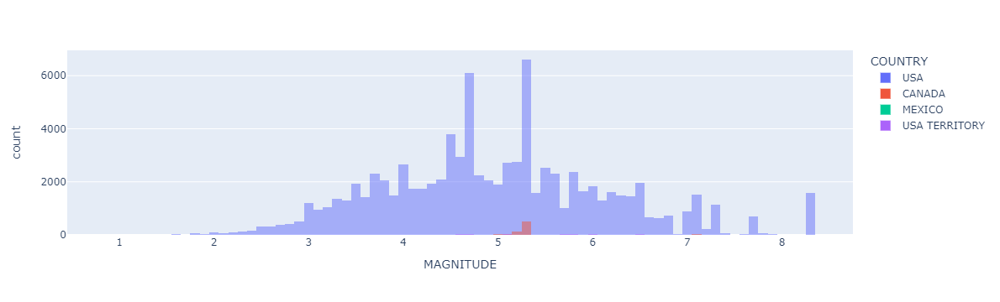

In [18]:
px.histogram(data_frame = sismosdf,
             x = 'MAGNITUDE',
             color = 'COUNTRY',
             barmode="overlay" #Aquí se ve lo de canadá
             )

## ¿Cuál es el estado con menos sismos históricos?

Recordando que la columna STATE contiene los Estados.

- ¿Cuál es el que tiene <b>más</b>?
- ¿En que orden de <b>intensidad</b> se encuentran estos estados?
- ¿Cuál es el estado con <b>intensidades menores</b> de sismos?


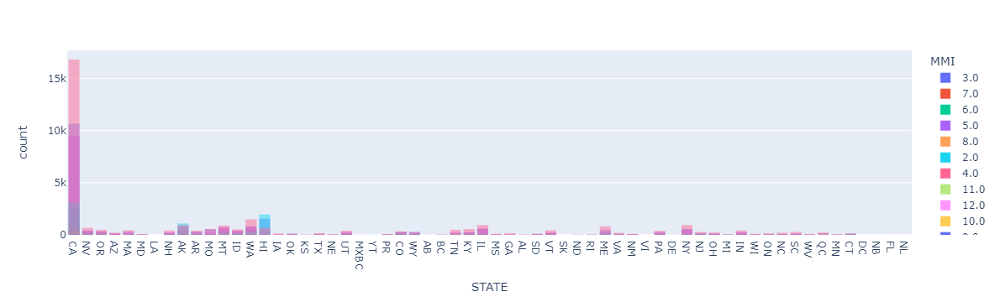

In [19]:
px.histogram(data_frame = sismosdf,
             x = 'STATE',
             color = 'MMI',
             barmode="overlay" 
             )

## ¿En que año se registraron más sismos?

Recordando que la columna de año es YEAR

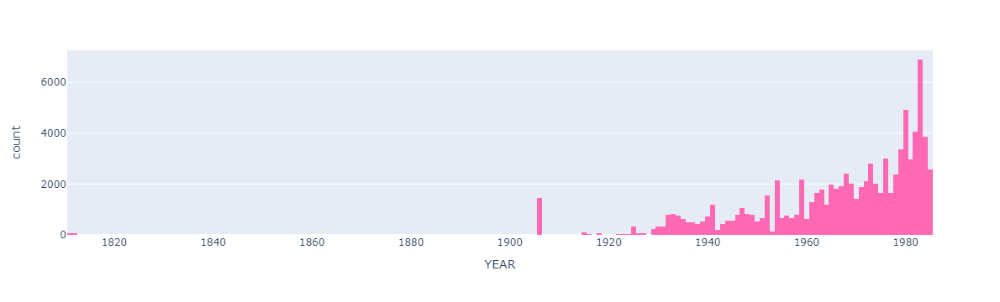

In [20]:
px.histogram(data_frame = sismosdf,
             x = 'YEAR',
             color_discrete_sequence = ['hotpink']
             )

## ¿A qué hora es más frecuente que tiemble?
La columna de hora es HOURS

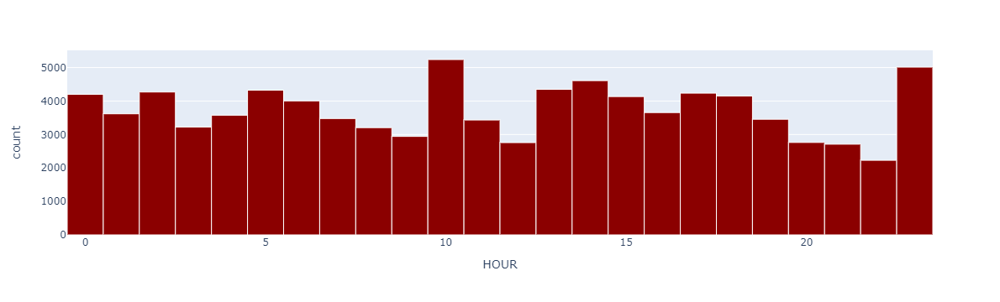

In [21]:
fig = px.histogram(data_frame = sismosdf,
             x = 'HOUR',
             color_discrete_sequence = ['darkred'])
fig.update_traces(marker_line_width=1,marker_line_color="white")

## Veamos representaciones visuales en mapas...

Contestemos las siguientes preguntas:
- ¿Cuáles son los estados que tiene <b>mayor intensidad</b> de sismos?
- ¿Cómo se ve la <b>distribución</b> de sismos históricos en un mapa?

Usemos las columnas de latitud (CITY_LAT) y longitud (CITY_LON) para visualizar en mapa las intensidades (MMI) de los sismos históricos


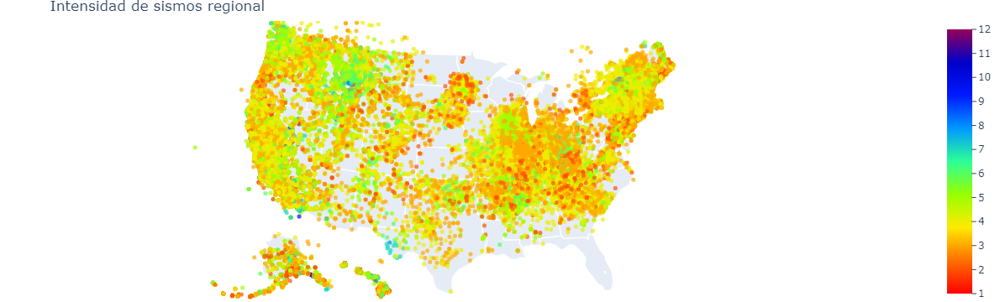

In [22]:
fig = go.Figure(data=go.Scattergeo(
        lon = sismosdf['CITY_LON'],
        lat = sismosdf['CITY_LAT'],
        text = sismosdf['MMI'],
        marker = dict(
        color = sismosdf['MMI'],
        colorscale = 'Rainbow',
        reversescale = True,
        opacity = 0.7,
        size = 5,
        colorbar = dict(
            titleside = "right",
            outlinecolor = "rgba(68, 68, 68, 0)",
            ticks = "outside",
            showticksuffix = "last",
            dtick = 1
        )
    )
        ))
fig.update_traces(marker=dict(size=15),
                  selector=dict(mode='markers'))
fig.update_layout(
    margin=dict(l=0, r=0, b=0, t=25),
    title = 'Intensidad de sismos regional',
    geo_scope='usa',
    )

fig.show()

## Ahora respondamos preguntas por año...

1.  ¿Dónde ocurrió sismo con mayor intensidad en el año de 1907?

2.  ¿En cuáles estados ocurrieron los sismos de menor intensidad en el año 1929?

3.  ¿De qué intensidad promedio fueron los sismos en Atlanta en 1968?

4.  ¿Cuál fue la magnitud del sismo de Intensidad 10 de 1971?

### ❗❗ OJO 👀

En este caso, la mejor estrategia es crear un <b>dashoboard interactivo</b> para poder visualizar por año cada una de las preguntas que debemos resolver. Vamos por pasos:


### Paso 1. Empecemos creando nuestras divisiones por Año y Mes
Nos interesa ver mapas graficados por año...

In [23]:
sismosdf = sismosdf.set_index(['YEAR', 'MONTH'])

In [24]:
sismosdf.head()

DAY  HOUR  MINUTE  SECOND  MAGNITUDE  EPIDIST  CITY_LAT  \
YEAR MONTH                                                             
1948 12.0   28.0  12.0    53.0    41.0        4.0     47.0     33.22   
     12.0   28.0  12.0    53.0    41.0        4.0     52.0     33.02   
     12.0   28.0  12.0    53.0    41.0        4.0     84.0     32.77   
     12.0   28.0  12.0    53.0    41.0        4.0    156.0     34.18   
     12.0   29.0  12.0    53.0    27.0        6.0     23.0     39.53   

            CITY_LON  MMI STATE                      CITY SOURCE COUNTRY  
YEAR MONTH                                                                
1948 12.0    -116.30  3.0    CA            BORREGO VALLEY      U     USA  
     12.0    -116.84  3.0    CA                 SAN DIEGO      U     USA  
     12.0    -117.02  3.0    CA                   LA MESA      U     USA  
     12.0    -118.17  3.0    CA  OAK GROVE RANGER STATION      U     USA  
     12.0    -119.81  7.0    NV                      RENO      U     USA

### Paso 2. Creamos una lista de estos Años

In [25]:
index_list = sismosdf.index.levels[0].tolist()
print(index_list)

[1811, 1812, 1899, 1900, 1904, 1906, 1908, 1909, 1910, 1911, 1912, 1915, 1916, 1917, 1918, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985]


### Paso 3. Generaremos imágenes por año de mapas 
Aquí mostraremos la intensidad (MMI) en el punto geográfico de sus respectivos epicentros (CITY_LAT, CITY_LON)

In [26]:
frames=[{'name': 'frame_{}'.format(i),
        # ESTO ES LO QUE DESPLEGAREMOS EN EL MAPA
        'data': [{
            'type': 'scattermapbox',
            'lat': sismosdf.xs(i)['CITY_LAT'],
            'lon': sismosdf.xs(i)['CITY_LON'],
            'marker': go.scattermapbox.Marker(
                size=(sismosdf.xs(i)['MMI']-sismosdf.xs(i)['MMI'].mean()+3.5)**2 +sismosdf.xs(i)['MMI'],
                color=sismosdf.xs(i)['MMI'],
                showscale=True,
                colorscale='Jet',
                colorbar={'title': 'Intensidad', 'titleside': 'top', 'thickness': 4, 'ticksuffix': ' MMI'}
                ),
        # ESTO ES LO QUE SE DESPLEGARÁ EN EL MAPA POR SISMO
        'customdata': np.stack((
            sismosdf.xs(i)['MMI'],
            sismosdf.xs(i)['MAGNITUDE'],
            pd.Series(sismosdf.xs(i).index)),
                axis=-1
                ),
        'hovertemplate': "<extra></extra><em> Intensidad  %{customdata[0]}<br>Magnitud  %{customdata[1]}",
        }],
    } for i in index_list]

### Paso 4. Realizaremos la barra deslizante para tener control sobre los años
Este <b>slider</b> nos ayudará a visualizar los diferentes mapas por año

In [27]:
sliders = [{
            'transition':{'duration': 0},
            'x':0.08,
            'len':0.88,
            'currentvalue':{'font':{'size':15}, 'prefix':'Año ', 'visible':True, 'xanchor':'center'},
            'steps':[
                {
                    'label':i,
                    'method':'animate',
                    'args':[
                        ['frame_{}'.format(i)],
                        {'mode':'immediate', 'frame':{'duration':1000, 'redraw': True}, 'transition':{'duration':1000, }}
                      ],
                } for i in index_list]
        }]

In [28]:
data = frames[0]['data']
#print(data)

### Paso 5. Añadimos las barras deslizantes que creamos a una plantilla (layout)

In [29]:
layout = go.Layout(
    sliders=sliders,
    margin=dict(l=0, r=0, b=0, t=25),
    title = 'Intensidad de sismos por año',
    mapbox={
        'accesstoken':'pk.eyJ1IjoiY2xhdWNvdCIsImEiOiJja2h4MTIxd2UwMzNzMnlvNzVycXN2dW14In0.J_KSzOY3YGDzozRdHvMJgQ',
        'center':{"lat": sismosdf['CITY_LAT'].mean(), "lon": sismosdf['CITY_LON'].mean()+10},
        'zoom':3,
        'style':'light',
    }
)

### Paso 6. Creamos nuestra gráfica interactiva! 👏👏👏

Por último sólo queda graficar nuestro dashboard interactivo pero no sin antes recordar las preguntas a las que debemos dar solución...

1. ¿Dónde ocurrió sismo con mayor intensidad en el año de 1907?

2. ¿En cuáles estados ocurrieron los sismos de menor intensidad en el año 1929?

3. ¿De qué intensidad promedio fueron los sismos en Atlanta en 1968?

4. ¿Cuál fue la magnitud del sismo de Intensidad 10 de 1971?

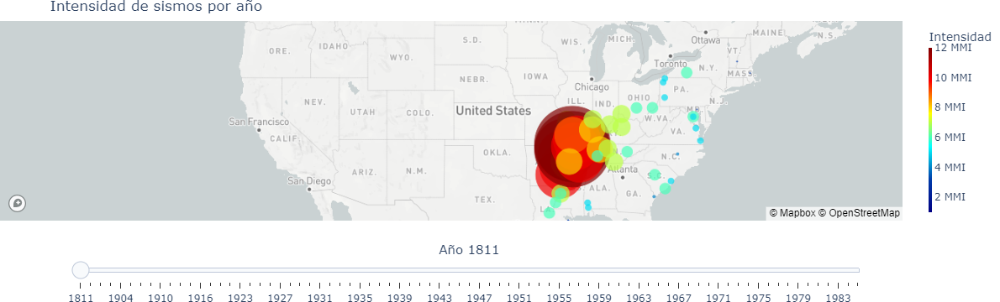

In [30]:
fig = go.Figure(data=data, layout=layout, frames=frames)
fig.show()